# Part 5. Optimized Return Model

In [1]:
from utils import *
plt.style.use('fivethirtyeight')

# Load Pre-Processed Data and Prepare Features for Machine Learning

In [33]:
tweet_stocks = pd.read_pickle('./data/pre_processed_df.pkl')

# Changing the return cutoff

In [123]:
new_df = pd.DataFrame()
labels = ['move','stay', 'move']
for user in list(tweet_stocks['username'].unique()):
    df = tweet_stocks[tweet_stocks['username'] == user]
    bins = [df['percent change'].min(), -0.0075, 0.0075, df['percent change'].max()]
    df['movement'] = pd.cut(df['percent change'], bins=bins, labels=labels, include_lowest=True, ordered=False)
    new_df = new_df.append(df)
    new_df.reset_index(inplace=True, drop=True)
tweet_stocks = new_df 

In [124]:
#df = tweet_stocks[tweet_stocks['username'] != 'richardbranson']

In [125]:
#branson = branson['2019-10-20':]
#branson.reset_index(inplace=True)
#df = df.append(branson)

In [126]:
numerical_feat = [
    'mentions', 'hashtags',
       'video', 'photos', 'urls',
       'number of tweets',
       'number of emojis', 'tweet length', 'number of sentences',
       'number of words', 'avg words per sentence', 'number of nouns',
       'number of verbs', 'number of stopwords', 'number of organizations',
       ]
text_feat = ['tweet', 'text', 'cleaned']
targets = []
all_scores = {}
cv_scores = {}
models = {}

In [127]:
labels = ['stay', 'move']
col_name = 'bins'
bin_name = 'bins'
df = tweet_stocks.copy(deep=True)
text_name = 'cleaned'
col_name = 'movement'
target_name = 'classification'

df[target_name] = 0
df[target_name][df[col_name] == labels[1]] = 1

# Separate Data into Training/Testing and put Testing Aside

In [128]:
full_df = df.copy(deep=True)
df_training, df_testing = train_test_split(full_df, test_size=0.3)

In [129]:
df = df_training.copy(deep=True)
df.reset_index(inplace=True, drop=True)

In [130]:
for user in df['username'].unique():
    df_usn = df[df['username'] == user].copy(deep=True)
    print(user.upper())
    chi2_sig(df_usn, col_name, numerical_feat, 'cleaned')

RICHARDBRANSON
Statistically Significant Words Per Bin
P_val = 0.95

# move:
  . selected features: 3
  . top features: hyperloop,icon,song
 
# stay:
  . selected features: 3
  . top features: hyperloop,icon,song
 
Statistically Significant Features Per Bin
P_val = 0.95

# move:
  . selected features: 8
  . top features: number of tweets,photos,video,urls,hashtags,number of verbs,number of nouns,number of words
 
# stay:
  . selected features: 8
  . top features: number of tweets,photos,video,urls,hashtags,number of verbs,number of nouns,number of words
 
JOHNLEGERE
Statistically Significant Words Per Bin
P_val = 0.95

# move:
  . selected features: 0
  . top features: 
 
# stay:
  . selected features: 0
  . top features: 
 
Statistically Significant Features Per Bin
P_val = 0.95

# move:
  . selected features: 5
  . top features: photos,video,number of tweets,hashtags,mentions
 
# stay:
  . selected features: 5
  . top features: photos,video,number of tweets,hashtags,mentions
 
ELONMU

# Changing Return Cutoff

Value Counts:
classification
0                 3041
1                 1993
dtype: int64


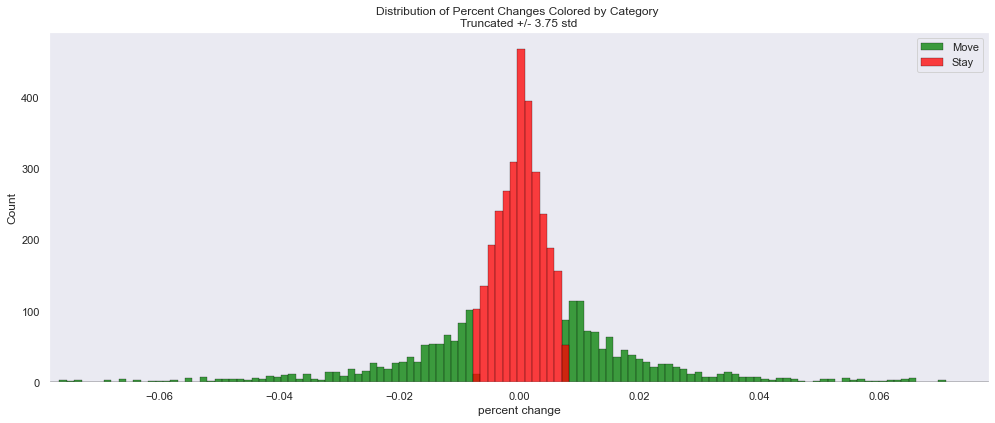

count    5034.000000
mean        0.000767
std         0.019581
min        -0.178809
25%        -0.004416
50%         0.000513
75%         0.006151
max         0.232461
Name: percent change, dtype: float64


In [131]:
# Define user, target, feature names
std = df['percent change'].std()
print('Value Counts:')
print(df[[target_name]].value_counts())
sns.set()
plt.figure(figsize=(15,6))
_ = sns.histplot(data = df, x='percent change',hue=target_name, stat='count', alpha=0.75, common_bins=True, palette=['red', 'green'], edgecolor='black')
plt.legend([0, 1, 2])
plt.title("Distribution of Percent Changes Colored by Category \nTruncated +/- 3.75 std")
plt.xlim(-4*std, 4*std)
plt.legend(['Move', 'Stay'])
plt.grid(False)
plt.savefig('./figures/modeling/{}_distribution.png'.format(target_name), bbox_inches='tight', transparent=True)
plt.savefig('./slides/figures/distribution_2pt5pct.png'.format(target_name), bbox_inches='tight', transparent=True)
plt.show()

print(df['percent change'].describe())

This dataset is imbalanced. The positive class (change) makes up only ~18% of data. As we are looking to see if Twitter data can predict that stocks will rise of fall within a certain percentage

# Hyperparameter Tuning

# Different Solvers

In [139]:
user = 'richardbranson'
df = df_training[df_training['username'] == user].copy(deep=True)
hyperparam_tuning = pd.DataFrame()
scoring = 'f1'
X, y = make_xy(df, target_name, numerical_feat, 'cleaned')
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size = 0.3, stratify=y)

#### lbfgs

In [140]:
%%time
# Clocked at 4min 9s

solver = 'lbfgs' # does not support l1 penalty
grid={
    "C":np.logspace(-3,3,7), "penalty":["l2", 'none'],
} 

clf = LogisticRegression(class_weight='balanced', n_jobs= -1, solver=solver)
clf_cv=GridSearchCV(clf,grid,cv=10, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['solver'] = solver
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)
print('solver: {}'.format(solver))

tuned hyperparameters :(best parameters)  {'C': 1.0, 'penalty': 'l2'}
best score : 0.5872766680010307
solver: lbfgs
CPU times: user 22.9 s, sys: 6.1 s, total: 29 s
Wall time: 1min 18s


#### newton-cg

In [142]:
%%time
# Clocked at 4min 48s
solver = 'newton-cg' # does not support l1 penalty
grid={
    "C":np.logspace(-3,3,7), "penalty":["l2", 'none'],
} 

clf = LogisticRegression(class_weight='balanced', n_jobs= -1, solver=solver)
clf_cv=GridSearchCV(clf,grid,cv=10, scoring=scoring)
clf_cv.fit(X_train,y_train)


hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['solver'] = solver
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)
print('solver: {}'.format(solver))

tuned hyperparameters :(best parameters)  {'C': 1.0, 'penalty': 'l2'}
best score : 0.5872766680010307
solver: newton-cg
CPU times: user 23.3 s, sys: 5.87 s, total: 29.2 s
Wall time: 1min 45s


#### sag

In [144]:
%%time
# Clocked at 5min 46s
solver = 'sag' 
grid={
    "C":np.logspace(-3,3,7), "penalty":["l2", 'none']
} 

clf = LogisticRegression(class_weight='balanced', n_jobs= -1, solver=solver)
clf_cv=GridSearchCV(clf,grid,cv=10, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['solver'] = solver
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)
print('solver: {}'.format(solver))

tuned hyperparameters :(best parameters)  {'C': 1.0, 'penalty': 'l2'}
best score : 0.5872766680010307
solver: sag
CPU times: user 23.9 s, sys: 5.65 s, total: 29.6 s
Wall time: 4min 18s


#### saga

In [146]:
%%time
# Clocked at 10min 9s
solver = 'saga' 
grid={
    "C":np.logspace(-3,3,7), "penalty":["l2", 'l1', 'none']
} 

clf = LogisticRegression(class_weight='balanced', n_jobs= -1, solver=solver)
clf_cv=GridSearchCV(clf,grid,cv=10, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['solver'] = solver
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)
print('solver: {}'.format(solver))

tuned hyperparameters :(best parameters)  {'C': 1.0, 'penalty': 'l2'}
best score : 0.5872766680010307
solver: saga
CPU times: user 36.6 s, sys: 8.68 s, total: 45.3 s
Wall time: 7min 58s


#### liblinear

In [148]:
%%time
# Clocked at 3min 17s
solver = 'liblinear' 
grid={
    "C":np.logspace(-3,3,7), "penalty":["l2", 'l1'], 'dual':[True, False], "intercept_scaling":[0.01, 0.01, 0.1, 1,10,100]
} 

clf = LogisticRegression(class_weight='balanced', n_jobs= -1, solver=solver)
clf_cv=GridSearchCV(clf,grid,cv=10, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['solver'] = solver
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)
print('solver: {}'.format(solver))

tuned hyperparameters :(best parameters)  {'C': 1.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l2'}
best score : 0.5915980261568496
solver: liblinear
CPU times: user 4min 29s, sys: 22 s, total: 4min 51s
Wall time: 4min 35s


In [150]:
hyperparam_tuning = hyperparam_tuning.sort_values(by='mean_test_score', ascending=False).reset_index(drop=True)

hyperparam_tuning[:5]

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_penalty,params,split0_test_score,split1_test_score,split2_test_score,...,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score,solver,clf,username,param_dual,param_intercept_scaling
0,0.137958,0.051925,0.061947,0.030693,1.0,l2,"{'C': 1.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l2'}",0.529412,0.514286,0.512821,...,0.625000,0.666667,0.591598,0.085299,1,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,10
1,0.102784,0.034950,0.041083,0.013893,1.0,l2,"{'C': 1.0, 'dual': False, 'intercept_scaling': 10, 'penalty': 'l2'}",0.529412,0.514286,0.512821,...,0.580645,0.666667,0.588339,0.082958,2,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,False,10
2,0.669739,0.133824,0.035582,0.004360,1.0,l2,"{'C': 1.0, 'penalty': 'l2'}",0.529412,0.514286,0.512821,...,0.580645,0.666667,0.587277,0.084283,1,newton-cg,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='newton-cg')",richardbranson,NaN,NaN
3,0.106231,0.035795,0.039208,0.011061,1.0,l2,"{'C': 1.0, 'dual': False, 'intercept_scaling': 100, 'penalty': 'l2'}",0.529412,0.514286,0.512821,...,0.580645,0.666667,0.587277,0.084283,3,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,False,100
4,1.357505,0.034082,0.030976,0.000621,1.0,l2,"{'C': 1.0, 'penalty': 'l2'}",0.529412,0.514286,0.512821,...,0.580645,0.666667,0.587277,0.084283,1,saga,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='saga')",richardbranson,NaN,NaN


In [151]:
top_params = hyperparam_tuning['params'].iloc[0]
top_params['solver'] =  hyperparam_tuning['solver'].iloc[0]

params_lgr = top_params
#clf = LogisticRegression(n_jobs=-1, class_weight='balanced')
#clf.set_params(**params_lgr)

print(clf)
print(clf.get_params())

LogisticRegression(class_weight='balanced', dual=True, intercept_scaling=10,
                   n_jobs=-1, solver='liblinear')
{'C': 1.0, 'class_weight': 'balanced', 'dual': True, 'fit_intercept': True, 'intercept_scaling': 10, 'l1_ratio': None, 'max_iter': 100, 'multi_class': 'auto', 'n_jobs': -1, 'penalty': 'l2', 'random_state': None, 'solver': 'liblinear', 'tol': 0.0001, 'verbose': 0, 'warm_start': False}


#### rbf

In [152]:
%%time
# Clocked at 11min
grid={
'C': np.logspace(-1,2,4), 'gamma': np.logspace(-4,1,6)
} 
kernel = 'rbf'


# Separate into Training/Testing
clf = SVC(class_weight='balanced', probability=True, kernel=kernel)
clf_cv=GridSearchCV(clf,grid,cv=5, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['kernel'] = kernel
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)

tuned hyperparameters :(best parameters)  {'C': 10.0, 'gamma': 0.01}
best score : 0.593271510096576
CPU times: user 8min 34s, sys: 11.2 s, total: 8min 45s
Wall time: 8min 52s


### poly

In [154]:
%%time
# Clocked at 7min 34s
grid={
'C': np.logspace(-1,2,4), 'gamma': np.logspace(-4,1,6)
} 
kernel = 'poly'



clf = SVC(class_weight='balanced', probability=True, kernel=kernel)
clf_cv=GridSearchCV(clf,grid,cv=5, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['kernel'] = kernel
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)

tuned hyperparameters :(best parameters)  {'C': 10.0, 'gamma': 0.1}
best score : 0.5601800007770137
CPU times: user 7min 25s, sys: 2.91 s, total: 7min 28s
Wall time: 7min 33s


#### sigmoid

In [156]:
%%time
# Clocked at 7min 34s
grid={
'C': np.logspace(-1,2,4), 'gamma': np.logspace(-4,1,6)
} 
kernel = 'sigmoid'


clf = SVC(class_weight='balanced', probability=True, kernel=kernel)
clf_cv=GridSearchCV(clf,grid,cv=5, scoring=scoring)
clf_cv.fit(X_train,y_train)

hyperparams = pd.DataFrame(clf_cv.cv_results_).sort_values(by='mean_test_score', ascending=False)
hyperparams['kernel'] = kernel
hyperparams['clf'] = clf_cv.estimator
hyperparams['username'] = user
hyperparam_tuning = hyperparam_tuning.append(hyperparams, ignore_index=True)

print("tuned hyperparameters :(best parameters) ",clf_cv.best_params_)
print("best score :",clf_cv.best_score_)

tuned hyperparameters :(best parameters)  {'C': 1.0, 'gamma': 0.1}
best score : 0.5849521899680941
CPU times: user 7min 49s, sys: 4.38 s, total: 7min 53s
Wall time: 8min 31s


In [158]:
# Use best model
hyperparam_tuning = hyperparam_tuning.sort_values(by='mean_test_score', ascending=False).reset_index(drop=True)
hyperparam_tuning

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_penalty,params,split0_test_score,split1_test_score,split2_test_score,...,mean_test_score,std_test_score,rank_test_score,solver,clf,username,param_dual,param_intercept_scaling,param_gamma,kernel
0,3.394272,0.034292,0.266031,0.003836,10.0,NaN,"{'C': 10.0, 'gamma': 0.01}",0.537313,0.600000,0.593750,...,0.593272,0.031585,1,NaN,"SVC(class_weight='balanced', probability=True)",richardbranson,NaN,NaN,0.01,rbf
1,0.137958,0.051925,0.061947,0.030693,1.0,l2,"{'C': 1.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l2', 'solver': 'liblinear'}",0.529412,0.514286,0.512821,...,0.591598,0.085299,1,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,10,NaN,NaN
2,3.601200,0.136100,0.272883,0.003536,100.0,NaN,"{'C': 100.0, 'gamma': 0.001}",0.537313,0.600000,0.584615,...,0.591445,0.031768,2,NaN,"SVC(class_weight='balanced', probability=True)",richardbranson,NaN,NaN,0.001,rbf
3,0.102784,0.034950,0.041083,0.013893,1.0,l2,"{'C': 1.0, 'dual': False, 'intercept_scaling': 10, 'penalty': 'l2'}",0.529412,0.514286,0.512821,...,0.588339,0.082958,2,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,False,10,NaN,NaN
4,0.106231,0.035795,0.039208,0.011061,1.0,l2,"{'C': 1.0, 'dual': False, 'intercept_scaling': 100, 'penalty': 'l2'}",0.529412,0.514286,0.512821,...,0.587277,0.084283,3,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,False,100,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
298,0.052721,0.000791,0.000000,0.000000,1000.0,l1,"{'C': 1000.0, 'dual': True, 'intercept_scaling': 0.01, 'penalty': 'l1'}",NaN,NaN,NaN,...,NaN,NaN,140,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,0.01,NaN,NaN
299,0.051967,0.000590,0.000000,0.000000,1000.0,l1,"{'C': 1000.0, 'dual': True, 'intercept_scaling': 0.1, 'penalty': 'l1'}",NaN,NaN,NaN,...,NaN,NaN,130,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,0.1,NaN,NaN
300,0.053408,0.001828,0.000000,0.000000,1000.0,l1,"{'C': 1000.0, 'dual': True, 'intercept_scaling': 1, 'penalty': 'l1'}",NaN,NaN,NaN,...,NaN,NaN,129,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,1,NaN,NaN
301,0.051603,0.000448,0.000000,0.000000,1000.0,l1,"{'C': 1000.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l1'}",NaN,NaN,NaN,...,NaN,NaN,132,liblinear,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')",richardbranson,True,10,NaN,NaN


In [159]:
hyperparam_tuning['solver'].value_counts()

liblinear    168
saga          21
newton-cg     14
sag           14
lbfgs         14
Name: solver, dtype: int64

In [160]:
best_models = hyperparam_tuning.copy(deep=True)

In [161]:
best_models[['clf', 'params', 'solver', 'kernel', 'username', 'mean_test_score', 'std_test_score', 'mean_fit_time', 'mean_score_time']][:3]

,clf,params,solver,kernel,username,mean_test_score,std_test_score,mean_fit_time,mean_score_time
0,"SVC(class_weight='balanced', probability=True)","{'C': 10.0, 'gamma': 0.01}",NaN,rbf,richardbranson,0.593272,0.031585,3.394272,0.266031
1,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 1.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l2', 'solver': 'liblinear'}",liblinear,NaN,richardbranson,0.591598,0.085299,0.137958,0.061947
2,"SVC(class_weight='balanced', probability=True)","{'C': 100.0, 'gamma': 0.001}",NaN,rbf,richardbranson,0.591445,0.031768,3.601200,0.272883


In [162]:
best_models['username'] = 'richardbranson'

In [163]:
best_models[['username', 'clf', 'params', 'solver', 'kernel','mean_test_score', 'std_test_score', 'mean_fit_time', 'mean_score_time']][:10]

,username,clf,params,solver,kernel,mean_test_score,std_test_score,mean_fit_time,mean_score_time
0,richardbranson,"SVC(class_weight='balanced', probability=True)","{'C': 10.0, 'gamma': 0.01}",NaN,rbf,0.593272,0.031585,3.394272,0.266031
1,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 1.0, 'dual': True, 'intercept_scaling': 10, 'penalty': 'l2', 'solver': 'liblinear'}",liblinear,NaN,0.591598,0.085299,0.137958,0.061947
2,richardbranson,"SVC(class_weight='balanced', probability=True)","{'C': 100.0, 'gamma': 0.001}",NaN,rbf,0.591445,0.031768,3.601200,0.272883
3,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 1.0, 'dual': False, 'intercept_scaling': 10, 'penalty': 'l2'}",liblinear,NaN,0.588339,0.082958,0.102784,0.041083
4,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='liblinear')","{'C': 1.0, 'dual': False, 'intercept_scaling': 100, 'penalty': 'l2'}",liblinear,NaN,0.587277,0.084283,0.106231,0.039208
5,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='newton-cg')","{'C': 1.0, 'penalty': 'l2'}",newton-cg,NaN,0.587277,0.084283,0.669739,0.035582
6,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='sag')","{'C': 1.0, 'penalty': 'l2'}",sag,NaN,0.587277,0.084283,0.840296,0.030978
7,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1)","{'C': 1.0, 'penalty': 'l2'}",lbfgs,NaN,0.587277,0.084283,0.449189,0.030359
8,richardbranson,"LogisticRegression(class_weight='balanced', n_jobs=-1, solver='saga')","{'C': 1.0, 'penalty': 'l2'}",saga,NaN,0.587277,0.084283,1.357505,0.030976
9,richardbranson,"SVC(class_weight='balanced', kernel='sigmoid', probability=True)","{'C': 1.0, 'gamma': 0.1}",NaN,sigmoid,0.584952,0.027166,3.274971,0.169352


In [164]:
clf = hyperparam_tuning['clf'].iloc[0]
hyperparam_tuning['params'].iloc[0]

{'C': 10.0, 'gamma': 0.01}

In [165]:
clf.set_params = hyperparam_tuning['params'].iloc[0]

In [166]:
clf.get_params()

{'C': 1.0,
 'break_ties': False,
 'cache_size': 200,
 'class_weight': 'balanced',
 'coef0': 0.0,
 'decision_function_shape': 'ovr',
 'degree': 3,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'probability': True,
 'random_state': None,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

# Running on test data

In [208]:
# Separate Training from Testing
user = 'richardbranson'
train_data = df_training.copy(deep=True)
train_data = train_data[train_data['username']==user]
test_data = df_testing.copy(deep=True)
test_data = test_data[test_data['username']==user]
train_data.reset_index(inplace=True, drop=True)
train_idx = train_data.index
start = len(train_data)
stop = len(train_data)+len(test_data)
test_idx = np.arange(start, stop)
test_data.index = test_idx

target_name = 'classification'
text_name = 'cleaned'
col_name = 'bins' 

df = pd.concat([train_data, test_data])

In [209]:
%%time
X, y = make_xy(df,
    target_name,
    numerical_feat,
    text_name)

X_train = X.loc[train_idx]
X_test = X.loc[test_idx]
y_train = y.loc[train_idx]
y_test = y.loc[test_idx]

clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)
print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.85      0.87       327
           1       0.55      0.61      0.58        96

    accuracy                           0.80       423
   macro avg       0.72      0.73      0.72       423
weighted avg       0.81      0.80      0.80       423

[[279  48]
 [ 37  59]]
CPU times: user 17 s, sys: 590 ms, total: 17.6 s
Wall time: 19.2 s


richardbranson
SVC(class_weight='balanced', probability=True)
The mean cross-validation accuracy is: 0.778 +/- 0.015
Precision: 0.551
Recall: 0.615
Balanced accuracy: 0.734
              precision    recall  f1-score   support

           0       0.88      0.85      0.87       327
           1       0.55      0.61      0.58        96

    accuracy                           0.80       423
   macro avg       0.72      0.73      0.72       423
weighted avg       0.81      0.80      0.80       423



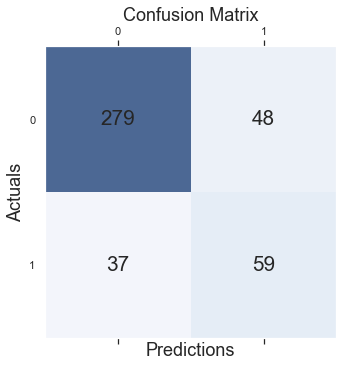

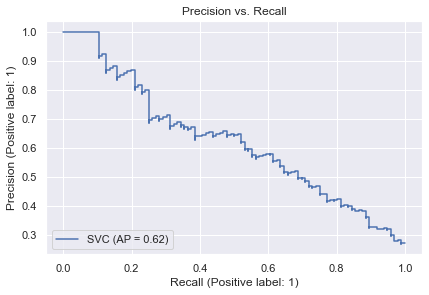

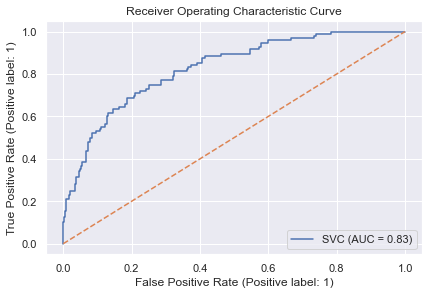

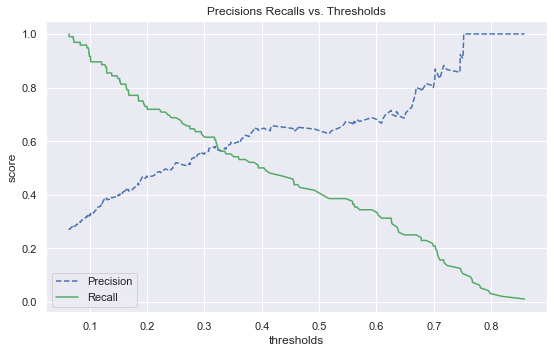

In [210]:
print(user)
print(clf)
full_report(clf, X_train, X_test, y_train, y_test)
y_proba = clf.predict_proba(X_test)
precisions, recalls, thresholds = precision_recall_curve(y_test, y_proba[:,1])
plt.figure(figsize=[8,5])
plot_precision_recall_vs_threshold(precisions, recalls, thresholds)

In [211]:
%%time
f1_scores = []
for thresh in thresholds:
    y_pred = (clf.predict_proba(X_test)[:,1] >= thresh).astype(int)
    f1 = f1_score(y_test, y_pred, pos_label=1)
    f1_scores.append(f1)
f1_scores = np.array(f1_scores)

CPU times: user 10min 27s, sys: 38.3 s, total: 11min 5s
Wall time: 13min 2s


In [212]:
best_f1 = f1_scores.max()

In [213]:
best_f1

0.595959595959596

In [214]:
idx = f1_scores.argsort()[-1]

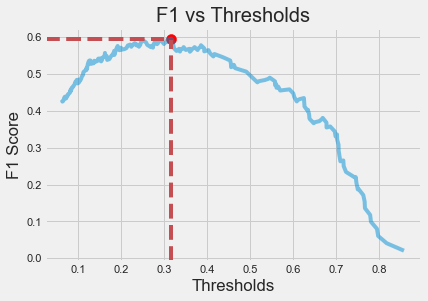

f1 score: 0.596
Threshold: 0.317


In [215]:
plt.style.use('fivethirtyeight')
plt.scatter(thresholds[idx], f1_scores[idx], color='red', alpha=1, s=100)
sns.lineplot(x=thresholds, y=f1_scores, alpha=0.5)
plt.xlabel('Thresholds')
plt.ylabel('F1 Score')
plt.title('F1 vs Thresholds')
plt.axvline(x=thresholds[idx], ymin=0, ymax=0.95, linestyle='--', c='r')
plt.axhline(y=best_f1, xmin=0, xmax=thresholds[idx], linestyle='--' ,c='r')
plt.show()

print('f1 score: {:.3f}\nThreshold: {:.3f}'.format(f1_scores[idx], thresholds[idx]))

Threshold: 0.317


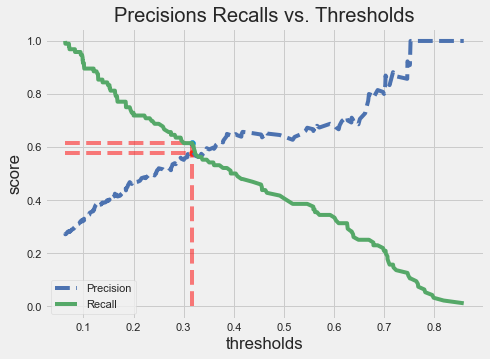

              precision    recall  f1-score   support

           0       0.88      0.87      0.88       327
           1       0.58      0.61      0.60        96

    accuracy                           0.81       423
   macro avg       0.73      0.74      0.74       423
weighted avg       0.82      0.81      0.81       423



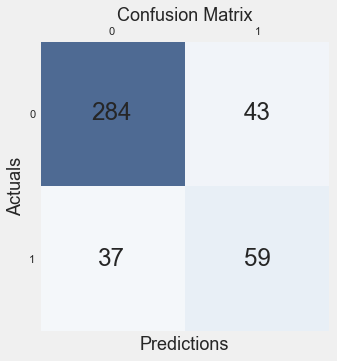

  Confusion Matrix Metrics
  How often is the classifier correct?
  Accuracy: 59.671%

  How often is it wrong?
  Error Rate: -58.671%

  When it's actually yes, how often does it predict yes?
  True Positive Rate (Recall): 61.458%

  When it predicts yes, how often is it correct?
  Precision: 57.843%

  When it's actually no, how often does it predict yes?
  False Positive Rate: 13.150%

  When it's actually no, how often does it predict no?
  True Negative Rate (Specificity): 86.850%
  F1 Score: 0.596
  Weighted F1 Score (beta = 2): 0.607
  G-mean: 0.596


In [218]:
thresh = plot_threshold(precisions, recalls, thresholds, clf, recall_thresh=0.61)

y_pred = (clf.predict_proba(X_test)[:,1] >= thresh).astype(int)
print(classification_report(y_test, y_pred))
plot_confusion_matrix(y_test, y_pred, show_metrics=True)

Threshold: 0.386


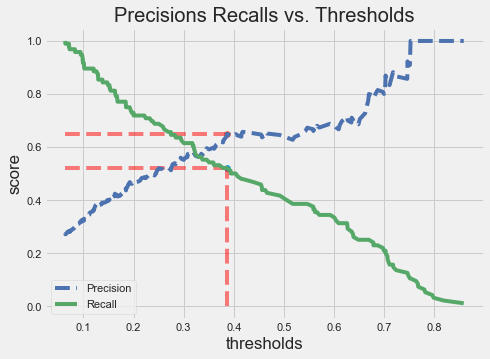

              precision    recall  f1-score   support

           0       0.87      0.92      0.89       327
           1       0.65      0.52      0.58        96

    accuracy                           0.83       423
   macro avg       0.76      0.72      0.73       423
weighted avg       0.82      0.83      0.82       423



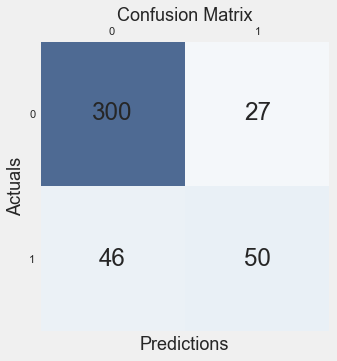

  Confusion Matrix Metrics
  How often is the classifier correct?
  Accuracy: 50.709%

  How often is it wrong?
  Error Rate: -49.709%

  When it's actually yes, how often does it predict yes?
  True Positive Rate (Recall): 52.083%

  When it predicts yes, how often is it correct?
  Precision: 64.935%

  When it's actually no, how often does it predict yes?
  False Positive Rate: 8.257%

  When it's actually no, how often does it predict no?
  True Negative Rate (Specificity): 91.743%
  F1 Score: 0.578
  Weighted F1 Score (beta = 2): 0.542
  G-mean: 0.582


In [227]:
thresh = plot_threshold(precisions, recalls, thresholds, clf, recall_thresh=0.52)

y_pred = (clf.predict_proba(X_test)[:,1] >= thresh).astype(int)
print(classification_report(y_test, y_pred))
plot_confusion_matrix(y_test, y_pred, show_metrics=True)

In [228]:
save_richardbranson = df.copy(deep=True)

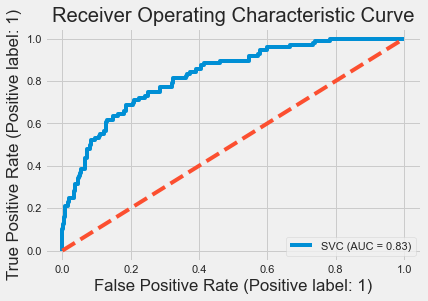

In [229]:
plot_roc_curve(clf, X_test, y_test, pos_label=1)
from sklearn.dummy import DummyClassifier
dummy_classifier = DummyClassifier(strategy="most_frequent")
dummy_classifier.fit(X_train, y_train)
y_score = dummy_classifier.predict_proba(X_test)
fpr, tpr, thresh = metrics.roc_curve(y_test, y_score[:,1])
auc = metrics.roc_auc_score(y_test, y_score[:,1])
plt.plot(fpr,tpr,label="data 2, auc="+str(auc), linestyle='--')
plt.title("Receiver Operating Characteristic Curve")
plt.show()

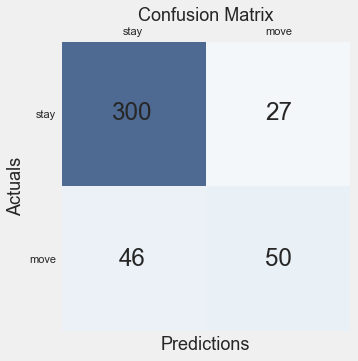

In [230]:
plt.style.use('fivethirtyeight')

mat = confusion_matrix(y_test, y_pred)
#https://vitalflux.com/python-draw-confusion-matrix-matplotlib/
fig, ax = plt.subplots(figsize=(5, 5))
ax.matshow(mat, cmap=plt.cm.Blues, alpha=0.7)
for i in range(mat.shape[0]):
    for j in range(mat.shape[1]):
        ax.text(x=j, y=i,s=mat[i, j], va='center', ha='center', size='xx-large')

plt.xlabel('Predictions', fontsize=18)
plt.xticks(ticks = [0,1], labels = ['stay', 'move'])
plt.yticks(ticks = [0,1], labels = ['stay', 'move'])
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.grid(False)

plt.show()

# Interpretation

In [231]:
most_predictive_words(clf, train_data['cleaned'], train_data['bins'], min_df=1)


 Most Predictive Words for bin: move
     
               ocean 0.39
                lady 0.39
              unveil 0.42
             welcome 0.43
             thought 0.46
             learner 0.52
              virgin 0.54
           fantastic 0.56
             america 0.56
        conversation 0.69

 Most Predictive Words for bin: stay
     
             million 0.93
               enjoy 0.93
                 get 0.93
              create 0.94
                fear 0.94
               thank 0.94
                 way 0.94
             support 0.95
                love 0.95
               quote 0.95




In [232]:
text = train_data['cleaned']
target = train_data['bins']
vectorizer = TfidfVectorizer(min_df=1)
X = vectorizer.fit_transform(text)
y = target
clf.fit(X, y)



SVC(class_weight='balanced', probability=True)

In [233]:
words_probs = pd.DataFrame()
words = np.array(vectorizer.get_feature_names())
x = np.eye(X.shape[1])
for i in range(len(clf.classes_)):
    probs = clf.predict_proba(x)[:, i]
    ind = np.argsort(probs)

    good_words = words[ind[-5:]]

    good_prob = probs[ind[-5:]]
    
    all_words = pd.DataFrame(columns=['words', 'probability', 'class'])
    all_words['words'] = good_words
    all_words['probability'] = good_prob
    all_words['class'] = clf.classes_[i]
    
    words_probs = words_probs.append(all_words)

    print("\n Most Predictive Words for bin: {}\n     ".format(clf.classes_[i]))
    for w, p in zip(good_words, good_prob):
        print("{:>20}".format(w), "{:.2f}".format(p))
print('\n')


 Most Predictive Words for bin: move
     
             learner 0.55
              virgin 0.58
           fantastic 0.59
             america 0.59
        conversation 0.73

 Most Predictive Words for bin: stay
     
               thank 0.94
                 way 0.94
             support 0.95
                love 0.95
               quote 0.96




Text(0.5, 1.0, 'Most Predictive Words per Class')

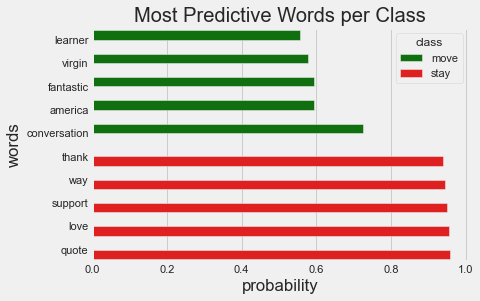

In [234]:
words_probs

sns.barplot(y='words', x='probability', data=words_probs, hue='class', palette=['green', 'red'])
plt.title('Most Predictive Words per Class')

In [235]:
target_word = 'virgin'
i = get_index(test_data['cleaned'], target_word)
test_data['tweet'].loc[i]

'Go ahead, laugh. The Funny Library Coffee Shop has officially opened its doors at @VirginHotelsSF  https://t.co/hsTguRcjR9  https://t.co/goP21dAomv “My father was killed because he had a vision of bringing people together. I refuse to allow anyone to reduce me to hatred.” @OfficialMLK3  https://t.co/9VoRCJie3i  https://t.co/OPOa7jW8Pa Wonderful, talented people are what makes @virgin so special – here’s a great example. Shaun Gunter might spend his days at @VirginActiveSA now but previously he was a professional gymnast and once trained @LennyKravitz  https://t.co/GQ482gsGOH #VirginFamily  https://t.co/mcoHoVSsEj Go ahead, laugh. Funny Library Coffee Shop has officially opened its doors at Virgin Hotels San Francisco  https://t.co/V9ItchOrHc  https://t.co/PAHsQam07J Wonderful hearing the wisdom @OfficialMLK3 learned from his father Martin Luther King, Jr, and a lifetime of public service  https://t.co/9VoRCJie3i  https://t.co/NpK20MDkMS Why we need more thermostat leaders in the world

[[0.9139649 0.0860351]]
Document id: 971
Percent Change: -0.001
Probability(Change) = 0.222
True class: stay


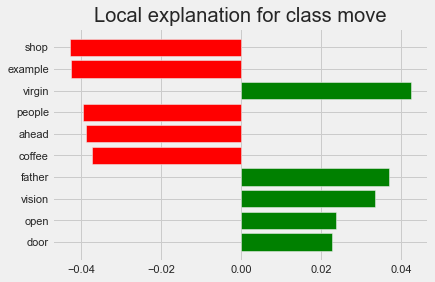

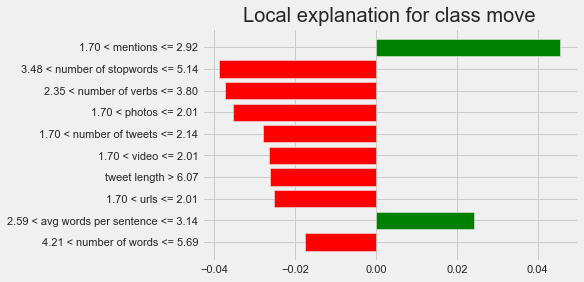

In [236]:
idx = i
class_names = ['stay', 'move']
interpret_instance(clf, train_data, test_data, class_names, idx, numerical_feat, 10)

New article about this drop:
https://www.cnbc.com/2021/07/12/virgin-galactic-shares-rise-after-successful-branson-flight-paves-wave-for-space-tourism-industry.html

In [237]:
classifications = pd.DataFrame()
classifications['actual'] = y_test.copy(deep=True)
classifications['percent change'] = test_data['percent change']
classifications['y_pred'] = y_pred
classifications['y_proba_1'] = y_proba[:,1]
misclassifications = classifications[classifications['actual'] != classifications['y_pred']]
correct_classifications = classifications[classifications['actual'] == classifications['y_pred']]
print('Incorrectly predicted actual {} as {} {} times'.format(labels[1].upper(),labels[0].upper(),len(misclassifications[misclassifications['actual'] == 1])))
print('Top 5 misclassifications')
misclassifications[misclassifications['actual'] == 1].sort_values(by='y_proba_1')[:5]

Incorrectly predicted actual MOVE as STAY 46 times
Top 5 misclassifications


,actual,percent change,y_pred,y_proba_1
1190,1,0.047939,0,0.063602
1228,1,0.069886,0,0.071135
1220,1,0.008929,0,0.071847
987,1,0.021858,0,0.083106
1064,1,0.007905,0,0.094241


In [238]:
classifications[classifications['actual'] == 1].sort_values(by='percent change')

,actual,percent change,y_pred,y_proba_1
1173,1,-0.176000,0,0.258636
1069,1,-0.170848,1,0.455938
1176,1,-0.155739,1,0.669420
1280,1,-0.151361,0,0.101094
1234,1,-0.112691,1,0.638639
...,...,...,...,...
1287,1,0.100170,1,0.697460
1364,1,0.127752,1,0.500000
1128,1,0.134672,1,0.600868
1199,1,0.169421,1,0.723686


Before the UK lockdown, I was delighted to surprise a classroom full of students in Devon who had been learning all about entrepreneurship in their business class  https://t.co/Mtzoi4ZATR @MadeByDyslexia @BCPschool  https://t.co/821jki7YyA 
2021-01-15 09:30:00


[[0.90808318 0.09191682]]
Document id: 1031
Percent Change: -0.033
Probability(Change) = 0.264
True class: move


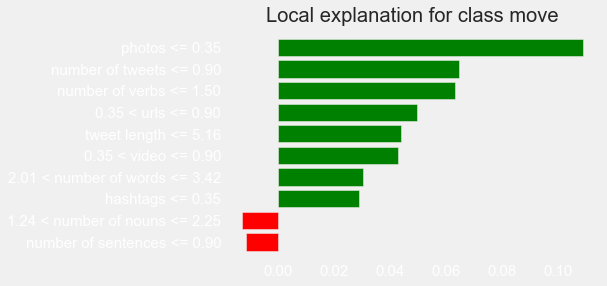

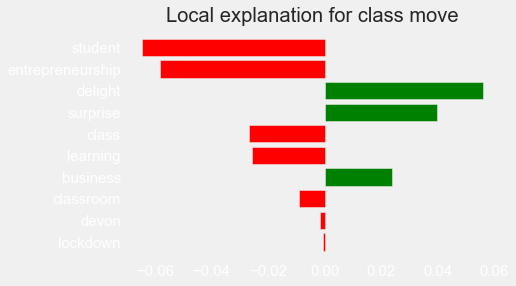

In [239]:
idx = 1031
print(test_data['tweet'].loc[idx])
print(test_data['date'].loc[idx])
class_names = ['stay', 'move']
feat_prob_visual(clf, train_data, test_data, class_names, numerical_feat, idx,  10)
text_prob_visual(clf, train_data, test_data, class_names, idx, 10)

In [241]:
idx = misclassifications[misclassifications['actual'] == 1].sort_values(by='y_proba_1').index[0]
test_data['tweet'].loc[idx]

'Great progress in @virgingalactic’s test flight programme means that the remaining hurdles, before our beautiful spaceship starts a full commercial service, are steadily being cleared  https://t.co/mk5dCNKulq  https://t.co/oLNeSe6zJO As we look back on the decade of Apollo with wonder and gratitude, I believe we can do so with the excitement that comes from knowing we are at the dawn of a new space age  https://t.co/mk5dCNKulq @virgingalactic @TheSpaceshipCo  https://t.co/TfRt5CAZNT .@VirginGalactic, along with its sister manufacturing organisation, @TheSpaceshipCo, has taken a huge step to becoming publicly listed and therefore available to equity investors  https://t.co/mk5dCNKulq  https://t.co/znZy2V0Qfw Delighted to share that @VirginGalactic has taken a huge step to becoming the first ever publicly listed human spaceflight company  https://t.co/mk5dCNKulq  https://t.co/RhVV28hYVJ How @Virgin is creating an inclusive #LGBTQ workplace  https://t.co/0yvc0R7qGV #VirginFamily  https:/

[[0.91121832 0.08878168]]
Document id: 1190
Percent Change: 0.048
Probability(Change) = 0.317
True class: move


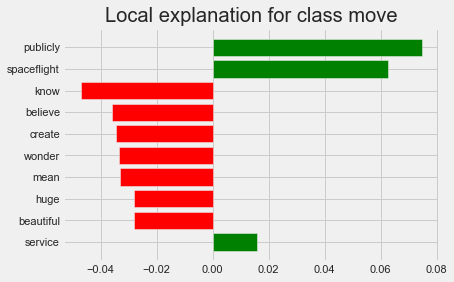

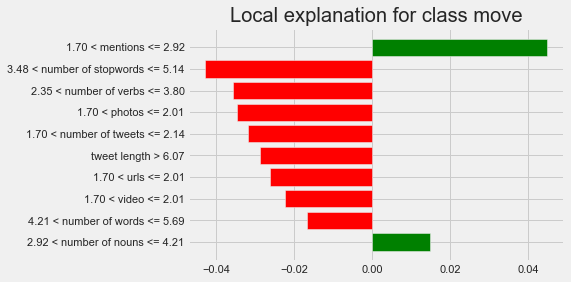

In [242]:
interpret_instance(clf, train_data, test_data, labels, idx, numerical_feat, 10)

In [243]:
# Greatest Change% Disparity

np.abs(misclassifications[misclassifications['actual'] == 1]).sort_values(by='percent change', ascending=False)[:5]

,actual,percent change,y_pred,y_proba_1
1173,1,0.176000,0,0.258636
1280,1,0.151361,0,0.101094
1077,1,0.102003,0,0.147562
1175,1,0.084022,0,0.199945
1344,1,0.083599,0,0.129294


In [244]:
idx = np.abs(misclassifications[misclassifications['actual'] == 1]).sort_values(by='percent change', ascending=False).index[0]
print('Predicted to be {} with {:.2f}% probability. Stock change is {:.2f}% '.format(labels[1].upper(), misclassifications['y_proba_1'].loc[idx] * 100, misclassifications['percent change'].loc[idx] *100))
#test_data['tweet'].loc[idx]

Predicted to be MOVE with 25.86% probability. Stock change is -17.60% 


In [245]:
test_data['tweet'].loc[idx]

'As we celebrate our 50th birthday, we’ve created a unique book to tell our story, featuring various dreams that have been turned into reality  https://t.co/ImgirInMgx #VirginByDesign #VirginFamily  https://t.co/fzpHHq4GZP Something I’ve been very excited about. Introducing #VirginByDesign - a special look behind the scenes of the culture and creativity that make the @Virgin brand unique  https://t.co/ImgirInMgx #VirginFamily #Virgin50  https://t.co/fsfETx6uLz '

[[0.90977292 0.09022708]]
Document id: 1173
Percent Change: -0.176
Probability(Change) = 0.266
True class: move


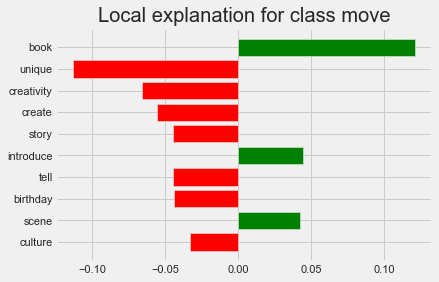

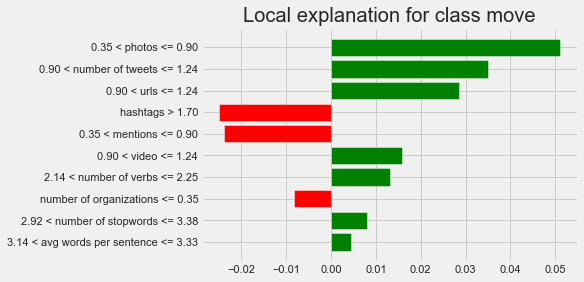

In [246]:
interpret_instance(clf, train_data, test_data, labels, idx, numerical_feat, 10)

In [247]:
print('Incorrectly predicted actual {} as {} {} times'.format(labels[0].upper(),labels[1].upper(),len(misclassifications[misclassifications['actual'] == 0])))
print('Top 5 misclassifications')
misclassifications[misclassifications['actual'] == 0].sort_values(by='y_proba_1', ascending=False)[:5]

Incorrectly predicted actual STAY as MOVE 27 times
Top 5 misclassifications


,actual,percent change,y_pred,y_proba_1
1019,0,0.005826,1,0.751051
1303,0,-0.000961,1,0.745782
1293,0,-0.003351,1,0.710535
1188,0,-0.007314,1,0.701971
1074,0,-0.001210,1,0.699403


In [248]:
idx = misclassifications[misclassifications['actual'] == 0].sort_values(by='y_proba_1', ascending=False).index[0]
test_data['tweet'].loc[idx]

'Very excited that the launch window for Virgin Orbit’s Launch Demo 2 mission opens this Sunday, with opportunities to launch throughout January. The brilliant team are making their way through final reviews, checks and readiness discussions, follow @Virgin_Orbit for the latest  https://t.co/ELfQmhAPBs '

In [249]:
test_data.loc[idx]

date                                                                                                                                                                                                                                                                                                                   2021-01-06 16:00:00
tweet                      Very excited that the launch window for Virgin Orbit’s Launch Demo 2 mission opens this Sunday, with opportunities to launch throughout January. The brilliant team are making their way through final reviews, checks and readiness discussions, follow @Virgin_Orbit for the latest  https://t.co/ELfQmhAPBs 
username                                                                                                                                                                                                                                                                                                                    richardbranson
mention

[[0.90570826 0.09429174]]
Document id: 1019
Percent Change: 0.006
Probability(Change) = 0.537
True class: stay


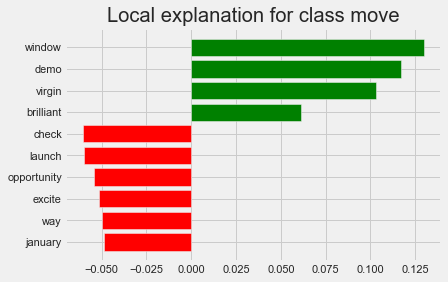

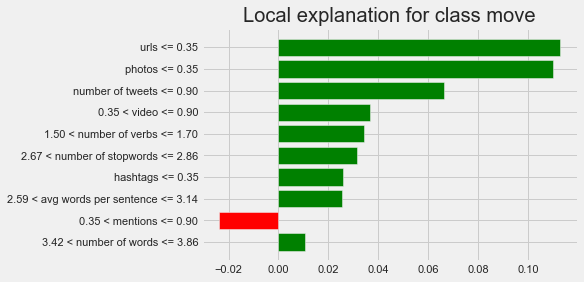

In [250]:
interpret_instance(clf, train_data, test_data, labels, idx, numerical_feat, 10)
#text_prob_visual_test(clf, train_data, test_data, labels, idx, numerical_feat)

In [251]:
idx = np.abs(misclassifications[misclassifications['actual'] == 0]).sort_values(by='percent change').index[0]
print('Predicted to be {} with {:.2f}% probability. Stock change is {:.2f}% '.format(labels[1].upper(), misclassifications['y_proba_1'].loc[idx] * 100, misclassifications['percent change'].loc[idx] *100))
test_data['tweet'].loc[idx]

Predicted to be MOVE with 55.86% probability. Stock change is 0.00% 


'Turtles have been on our planet for 100 million years – yet their future is uncertain  https://t.co/wHSNxMUO6H  https://t.co/kLQeCujBHy '

[[0.91742747 0.08257253]]
Document id: 1245
Percent Change: 0.000
Probability(Change) = 0.296
True class: stay


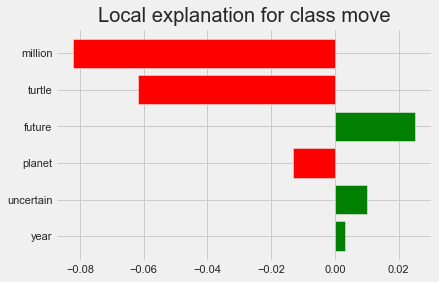

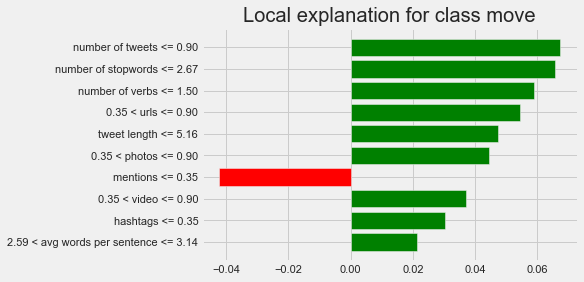

In [252]:
interpret_instance(clf, train_data, test_data, labels, idx, numerical_feat, 10)

In [253]:
best_lgr_classifications = classifications
classifications

,actual,percent change,y_pred,y_proba_1
963,0,0.000000,0,0.059115
964,0,0.001967,0,0.198850
965,0,-0.007035,0,0.156811
966,0,-0.000996,0,0.018597
967,0,0.000994,0,0.076403
...,...,...,...,...
1381,0,0.000000,0,0.350882
1382,1,-0.027809,1,0.703073
1383,0,-0.000969,0,0.164702
1384,0,0.000951,0,0.182427


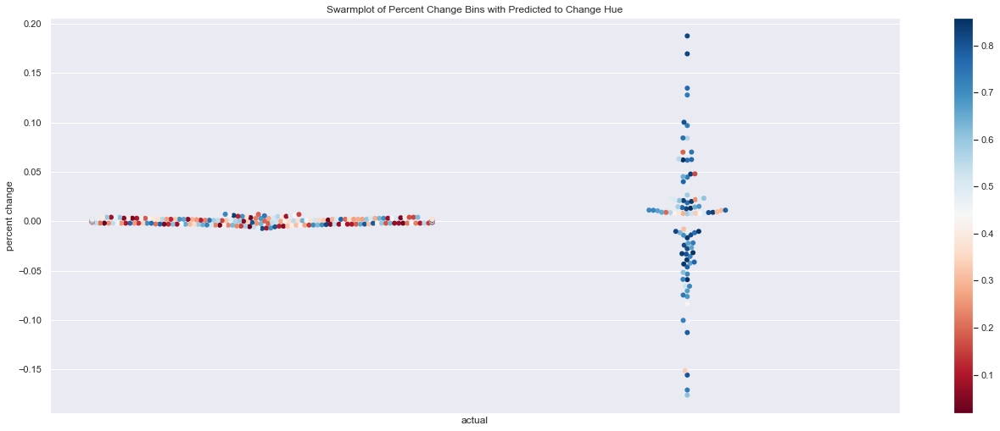

In [255]:
#### sns.set()
fig, ax = plt.subplots(figsize=(20,8))
ax = sns.swarmplot(y="percent change", x='actual', hue="y_proba_1", palette='RdBu', data=classifications, size=6)
norm = plt.Normalize(classifications['y_proba_1'].min(), classifications['y_proba_1'].max())
sm = plt.cm.ScalarMappable(cmap="RdBu", norm=norm)
sm.set_array([])

# Remove the legend and add a colorbar
ax.get_legend().remove()
ax.figure.colorbar(sm)
plt.title('Swarmplot of Percent Change Bins with Predicted to Change Hue')
plt.xticks(ticks=[])
plt.savefig('./figures/modeling/swarmplot_pred.png', bbox_inches='tight', transparent=True)

plt.show()

In [257]:
chi2_sig(df, bin_name, numerical_feat, 'cleaned')

Statistically Significant Words Per Bin
P_val = 0.95

# move:
  . selected features: 12
  . top features: blow,conversation,bubble,breathtake,rocketpowered,aha,promise,burden,whitehouse,scenery
 
# stay:
  . selected features: 12
  . top features: blow,conversation,bubble,breathtake,rocketpowered,aha,promise,burden,whitehouse,scenery
 
Statistically Significant Features Per Bin
P_val = 0.95

# move:
  . selected features: 6
  . top features: photos,number of tweets,video,urls,number of verbs,hashtags
 
# stay:
  . selected features: 6
  . top features: photos,number of tweets,video,urls,number of verbs,hashtags
 
